### Analyses of output files from the pipeline optimus v6.0.0
#### Aim of this part of analysis is to check if the output file from the pipeline is correct by realizing some preprocessing and visualization

#### 1. Load necessary libraries and useful functions

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import scanpy as sc
import anndata as ad
import seaborn as sns
import numpy as np
from scipy.stats import median_abs_deviation
import pandas as pd
import dalmatian as dm
import collections

In [3]:
import fsspec
import anndata
import pandas as pd
from typing import Union

def read_file_from_url(url: str) -> Union[anndata.AnnData, pd.DataFrame]:
    """Read a file from a URL and return the appropriate data structure.

    Parameters
    ----------
    url : str
        The URL of the file to read.

    Returns
    -------
    output : Union[anndata.AnnData, pd.DataFrame]
        The data read from the file, which can be either an AnnData object (if ".h5ad" in url)
        or a Pandas DataFrame (if ".csv" in url).
    """

    with fsspec.open(url) as f:
        if ".h5ad" in url:
            output = anndata.read_h5ad(f)
        elif "Summary.csv" in url:
            output = pd.read_csv(f, header=None) #Read the CSV file with the first row as data
        elif ".csv" in url:
            output = pd.read_csv(f)
        else:
            raise ValueError("Unsupported file format. Supported formats are .h5ad and .csv.")
    
    return output

#### 2. Data Loading

In this analysis, we load the data from the output file of job (submission iD 96ae8c73-2b91-4a30-b188-2a25a341a459)

In [5]:
TERRA_WS = "whitelabgx/scRNAseq"
wm = dm.WorkspaceManager(TERRA_WS)
output_df = wm.get_sample_sets()
display(output_df)
display(output_df.columns)

,aligner_metrics,bam,cell_barcodes_csv,cell_calls,cell_metrics,gene_metrics,genomic_reference_version,h5ad_output_file,html_report_array,matrix,matrix_col_index,matrix_row_index,metrics_csv_array,samples,summary_pdf
sample_set_id,,,,,,,,,,,,,,,
optimus_V6.0.0_wlg,gs://fc-447aee29-8362-4c0b-b8d0-b3b10eb9e2a6/s...,gs://fc-447aee29-8362-4c0b-b8d0-b3b10eb9e2a6/s...,gs://fc-447aee29-8362-4c0b-b8d0-b3b10eb9e2a6/s...,gs://fc-447aee29-8362-4c0b-b8d0-b3b10eb9e2a6/s...,gs://fc-447aee29-8362-4c0b-b8d0-b3b10eb9e2a6/s...,gs://fc-447aee29-8362-4c0b-b8d0-b3b10eb9e2a6/s...,gs://fc-447aee29-8362-4c0b-b8d0-b3b10eb9e2a6/s...,gs://fc-447aee29-8362-4c0b-b8d0-b3b10eb9e2a6/s...,[gs://fc-447aee29-8362-4c0b-b8d0-b3b10eb9e2a6/...,gs://fc-447aee29-8362-4c0b-b8d0-b3b10eb9e2a6/s...,gs://fc-447aee29-8362-4c0b-b8d0-b3b10eb9e2a6/s...,gs://fc-447aee29-8362-4c0b-b8d0-b3b10eb9e2a6/s...,[gs://fc-447aee29-8362-4c0b-b8d0-b3b10eb9e2a6/...,"[pbmc_10k_v3_S1_L001, pbmc_10k_v3_S1_L002]",gs://fc-447aee29-8362-4c0b-b8d0-b3b10eb9e2a6/s...


Index(['aligner_metrics', 'bam', 'cell_barcodes_csv', 'cell_calls',
       'cell_metrics', 'gene_metrics', 'genomic_reference_version',
       'h5ad_output_file', 'html_report_array', 'matrix', 'matrix_col_index',
       'matrix_row_index', 'metrics_csv_array', 'samples', 'summary_pdf'],
      dtype='object')

#### 2.1. h5ad file

In [6]:
### Load h5ad file
h5ad_url = output_df.loc['optimus_V6.0.0_wlg', 'h5ad_output_file']
adata = read_file_from_url(h5ad_url)

/opt/homebrew/Caskroom/miniconda/base/envs/bulk/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [ ]:
### Option: Load the data locally
#input_h5ad = "path/to/my.h5ad"
#adata = sc.read_h5ad(input_h5ad)

In [7]:
adata

AnnData object with n_obs × n_vars = 1136912 × 58347
    obs: 'cell_names', 'CellID', 'emptydrops_Limited', 'emptydrops_IsCell', 'n_reads', 'noise_reads', 'perfect_molecule_barcodes', 'reads_mapped_exonic', 'reads_mapped_exonic_as', 'reads_mapped_intronic', 'reads_mapped_intronic_as', 'reads_mapped_uniquely', 'reads_mapped_multiple', 'duplicate_reads', 'spliced_reads', 'antisense_reads', 'n_molecules', 'n_fragments', 'fragments_with_single_read_evidence', 'molecules_with_single_read_evidence', 'perfect_cell_barcodes', 'reads_mapped_intergenic', 'reads_unmapped', 'reads_mapped_too_many_loci', 'n_genes', 'genes_detected_multiple_observations', 'emptydrops_Total', 'molecule_barcode_fraction_bases_above_30_mean', 'molecule_barcode_fraction_bases_above_30_variance', 'genomic_reads_fraction_bases_quality_above_30_mean', 'genomic_reads_fraction_bases_quality_above_30_variance', 'genomic_read_quality_mean', 'genomic_read_quality_variance', 'reads_per_molecule', 'reads_per_fragment', 'fragments

In [9]:
### Find duplicate variable (gene) names
var_names = adata.var_names
duplicates = [item for item, count in collections.Counter(var_names).items() if count > 1]

print("Duplicate variable names:", duplicates)
print("Number of duplicate variable:", len(duplicates))

Duplicate variable names: ['U6', 'TP73-AS1', 'Y_RNA', 'SNORA77', 'SCARNA16', 'SNORA70', 'SCARNA11', 'SCARNA17', 'SCARNA18', 'snoU13', 'SNORA44', 'SNORA16A', 'SCARNA24', 'Metazoa_SRP', 'uc_338', 'SNORA62', 'SNORA63', 'SNORD46', 'SNORD38B', 'SNORA26', 'SNORA58', 'DLEU2_6', 'DLEU2_5', 'DLEU2_4', 'DLEU2_3', 'DLEU2_2', 'DLEU2_1', 'SNORA31', 'SNORA2', 'SNORD81', 'SNORA51', 'SNORA25', 'SNORA42', 'U3', 'SNORA40', '7SK', 'U1', 'U2', '5S_rRNA', 'U6atac', 'U4', 'SNORD59', 'SCARNA4', 'SNORD64', 'ACA64', 'RGS5', 'SCARNA20', 'U7', 'SNORA67', 'SNORA72', 'SNORD60', 'SNORD116', 'U8', 'LINC01115', 'SNORD18', 'SCARNA21', 'SNORA36', 'SNORD75', 'TMEM247', 'STPG4', 'SNORA75', 'SNORA12', 'SNORD78', 'ACA59', 'SNORA74', 'snoU109', 'SNORA19', 'ACTR3BP2', 'DAOA-AS1_2', 'SCARNA15', 'SNORA48', 'SNORD56', 'PDE11A', 'SNORA43', 'SNORA17', 'PCGEM1', 'SNORA4', 'SNORD70', 'SNORD11', 'SNORA1', 'Vault', 'SNORD51', 'SCARNA6', 'SNORD39', 'LINC01238', 'GHRLOS', 'SNORD5', 'SNORA64', 'SNORD77', 'PRSS50', 'CYB561D2', 'SNORD19B'

In [10]:
### Variable names are not unique. To make them unique
adata.var_names_make_unique()

/opt/homebrew/Caskroom/miniconda/base/envs/bulk/lib/python3.9/site-packages/anndata/utils.py:111: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['SNORD116-1', 'SNORD116-2', 'SNORD116-3', 'SNORD116-4', 'SNORD116-5']
  warnings.warn(


#### 2.2. STARsolo summary

In [11]:
### Load STARsolo summary file
star_summary_url = "gs://fc-447aee29-8362-4c0b-b8d0-b3b10eb9e2a6/submissions/96ae8c73-2b91-4a30-b188-2a25a341a459/Optimus/be8bc5cc-dfaf-4e7f-905c-e92735750bb5/call-STARsoloFastq/shard-1/cacheCopy/Summary.csv"
star_summary = read_file_from_url(star_summary_url)
display(star_summary)

,0,1
0,Number of Reads,319930655
1,Reads With Valid Barcodes,0.973214
2,Sequencing Saturation,0.667937
3,Q30 Bases in CB+UMI,0.931203
4,Q30 Bases in RNA read,0.901736
5,Reads Mapped to Genome: Unique+Multiple,0.961733
6,Reads Mapped to Genome: Unique,0.889793
7,Reads Mapped to Gene: Unique+Multiple Gene,NoMulti
8,Reads Mapped to Gene: Unique Gene,0.47964
9,Estimated Number of Cells,5356


#### 3. Check if we have zero counts droplets

In [27]:
zero_count_cell = adata.obs.loc[adata.obs.n_reads == 0, :]
zero_count_cell

,cell_names,CellID,emptydrops_Limited,emptydrops_IsCell,n_reads,noise_reads,perfect_molecule_barcodes,reads_mapped_exonic,reads_mapped_exonic_as,reads_mapped_intronic,...,fragments_per_molecule,cell_barcode_fraction_bases_above_30_mean,cell_barcode_fraction_bases_above_30_variance,n_mitochondrial_genes,n_mitochondrial_molecules,pct_mitochondrial_molecules,emptydrops_LogProb,emptydrops_PValue,emptydrops_FDR,input_id


In [24]:
"""
# the same as above
no_0count_cell = adata.obs.loc[adata.obs.n_reads != 0, :]
no_0count_cell
"""

,cell_names,CellID,emptydrops_Limited,emptydrops_IsCell,n_reads,noise_reads,perfect_molecule_barcodes,reads_mapped_exonic,reads_mapped_exonic_as,reads_mapped_intronic,...,fragments_per_molecule,cell_barcode_fraction_bases_above_30_mean,cell_barcode_fraction_bases_above_30_variance,n_mitochondrial_genes,n_mitochondrial_molecules,pct_mitochondrial_molecules,emptydrops_LogProb,emptydrops_PValue,emptydrops_FDR,input_id
AAACCCAAGAAACACT,AAACCCAAGAAACACT,AAACCCAAGAAACACT,True,False,1,0,1,1,0,0,...,1.000000,0.937500,NaN,0,0,0.000000,NaN,NaN,NaN,10k_pbmc_v3
AAACCCAAGAAACCAT,AAACCCAAGAAACCAT,AAACCCAAGAAACCAT,True,False,1,0,1,1,0,0,...,1.000000,1.000000,NaN,0,0,0.000000,NaN,NaN,NaN,10k_pbmc_v3
AAACCCAAGAAACTAC,AAACCCAAGAAACTAC,AAACCCAAGAAACTAC,True,False,3,0,3,3,0,0,...,2.000000,1.000000,0.000000,0,0,0.000000,NaN,NaN,NaN,10k_pbmc_v3
AAACCCAAGAAACTCA,AAACCCAAGAAACTCA,AAACCCAAGAAACTCA,True,False,120,0,120,76,0,0,...,1.066038,0.953646,0.004956,3,4,3.333333,NaN,NaN,NaN,10k_pbmc_v3
AAACCCAAGAAACTGT,AAACCCAAGAAACTGT,AAACCCAAGAAACTGT,True,False,3,0,3,2,0,0,...,1.000000,0.958333,0.005208,0,0,0.000000,NaN,NaN,NaN,10k_pbmc_v3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGTCTTGGTCC,TTTGTTGTCTTGGTCC,TTTGTTGTCTTGGTCC,True,False,1,0,1,1,0,0,...,1.000000,0.937500,NaN,0,0,0.000000,NaN,NaN,NaN,10k_pbmc_v3
TTTGTTGTCTTGTACC,TTTGTTGTCTTGTACC,TTTGTTGTCTTGTACC,True,False,1,0,1,1,0,0,...,1.000000,0.562500,NaN,0,0,0.000000,NaN,NaN,NaN,10k_pbmc_v3
TTTGTTGTCTTTACAC,TTTGTTGTCTTTACAC,TTTGTTGTCTTTACAC,True,False,1,0,1,1,0,0,...,1.000000,0.937500,NaN,0,0,0.000000,NaN,NaN,NaN,10k_pbmc_v3
TTTGTTGTCTTTGCGC,TTTGTTGTCTTTGCGC,TTTGTTGTCTTTGCGC,True,False,52,0,52,27,0,0,...,1.181818,0.888221,0.020885,3,3,5.769231,NaN,NaN,NaN,10k_pbmc_v3


#### 4. EmptyDrop results and filtering

In [21]:
### fetch the rows where the column emptydrops_IsCell is True
emptydrops_IsCell_true = adata.obs.loc[adata.obs.emptydrops_IsCell, :]
#emptydrops_IsCell_true= adata.obs[adata.obs['emptydrops_IsCell'] == True]
emptydrops_IsCell_true_FDR001 = emptydrops_IsCell_true.loc[emptydrops_IsCell_true.emptydrops_FDR < 0.001, :]
display(emptydrops_IsCell_true.shape)
display(emptydrops_IsCell_true_FDR001.shape)

(11031, 45)

(10710, 45)

In [22]:
emptydrops_IsCell_true_FDR001

,cell_names,CellID,emptydrops_Limited,emptydrops_IsCell,n_reads,noise_reads,perfect_molecule_barcodes,reads_mapped_exonic,reads_mapped_exonic_as,reads_mapped_intronic,...,fragments_per_molecule,cell_barcode_fraction_bases_above_30_mean,cell_barcode_fraction_bases_above_30_variance,n_mitochondrial_genes,n_mitochondrial_molecules,pct_mitochondrial_molecules,emptydrops_LogProb,emptydrops_PValue,emptydrops_FDR,input_id
AAACCCAAGCGCCCAT,AAACCCAAGCGCCCAT,AAACCCAAGCGCCCAT,True,True,22134,0,21987,8312,0,0,...,2.868404,0.933759,0.008753,10,201,0.908105,-4075.569995,0.000100,0.000191,10k_pbmc_v3
AAACCCAAGGTTCCGC,AAACCCAAGGTTCCGC,AAACCCAAGGTTCCGC,True,True,136975,0,135581,81724,0,0,...,2.878858,0.948245,0.008612,17,5144,3.755430,-14284.870262,0.000100,0.000000,10k_pbmc_v3
AAACCCACAGACAAGC,AAACCCACAGACAAGC,AAACCCACAGACAAGC,True,True,2598,0,2556,2069,0,0,...,2.755291,0.942071,0.008083,11,189,7.274827,-1742.751745,0.000100,0.000191,10k_pbmc_v3
AAACCCACAGAGTTGG,AAACCCACAGAGTTGG,AAACCCACAGAGTTGG,False,True,33474,0,33055,21574,0,0,...,2.532718,0.942177,0.009162,15,2080,6.213778,-6403.743800,0.012099,0.000000,10k_pbmc_v3
AAACCCACAGGTATGG,AAACCCACAGGTATGG,AAACCCACAGGTATGG,True,True,46998,0,46555,21305,0,0,...,2.766109,0.942274,0.008886,14,1657,3.525682,-7813.832561,0.000100,0.000000,10k_pbmc_v3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTCTGTAAC,TTTGTTGGTCTGTAAC,TTTGTTGGTCTGTAAC,True,True,46463,0,46088,22185,0,0,...,2.712271,0.934133,0.011230,15,2133,4.590750,-6583.492578,0.000100,0.000000,10k_pbmc_v3
TTTGTTGGTGCGTCGT,TTTGTTGGTGCGTCGT,TTTGTTGGTGCGTCGT,False,True,26312,0,26021,15879,0,0,...,2.286942,0.927414,0.012791,13,937,3.561113,-5276.938227,1.000000,0.000000,10k_pbmc_v3
TTTGTTGTCCAAGCCG,TTTGTTGTCCAAGCCG,TTTGTTGTCCAAGCCG,False,True,46399,0,46069,22111,0,0,...,2.781692,0.935541,0.010869,13,1968,4.241471,-6159.351991,0.085191,0.000000,10k_pbmc_v3
TTTGTTGTCTTACTGT,TTTGTTGTCTTACTGT,TTTGTTGTCTTACTGT,False,True,54064,0,53607,26158,0,0,...,2.712214,0.934584,0.011367,13,1671,3.090781,-6694.600359,0.152185,0.000000,10k_pbmc_v3


#### 5. recalculated %mt in optimus pipeline

In [47]:
adata.obs[["n_reads", "reads_mapped_exonic","n_mitochondrial_molecules", "pct_mitochondrial_molecules"]]

,n_reads,reads_mapped_exonic,n_mitochondrial_molecules,pct_mitochondrial_molecules
AAACCCAAGAAACACT,1,1,0,0.000000
AAACCCAAGAAACCAT,1,1,0,0.000000
AAACCCAAGAAACTAC,3,3,0,0.000000
AAACCCAAGAAACTCA,120,76,4,3.333333
AAACCCAAGAAACTGT,3,2,0,0.000000
...,...,...,...,...
TTTGTTGTCTTGGTCC,1,1,0,0.000000
TTTGTTGTCTTGTACC,1,1,0,0.000000
TTTGTTGTCTTTACAC,1,1,0,0.000000
TTTGTTGTCTTTGCGC,52,27,3,5.769231


In [26]:
adata.obs[["n_reads", "reads_mapped_exonic", "reads_mapped_exonic_as", "reads_mapped_intronic", "reads_mapped_intronic_as"]]
#"pct_mitochondrial_molecules", "n_mitochondrial_molecules"

,n_reads,perfect_molecule_barcodes,reads_mapped_exonic,reads_mapped_exonic_as,reads_mapped_intronic,reads_mapped_intronic_as
AAACCCAAGAAACACT,1,1,1,0,0,0
AAACCCAAGAAACCAT,1,1,1,0,0,0
AAACCCAAGAAACTAC,3,3,3,0,0,0
AAACCCAAGAAACTCA,120,120,76,0,0,0
AAACCCAAGAAACTGT,3,3,2,0,0,0
...,...,...,...,...,...,...
TTTGTTGTCTTGGTCC,1,1,1,0,0,0
TTTGTTGTCTTGTACC,1,1,1,0,0,0
TTTGTTGTCTTTACAC,1,1,1,0,0,0
TTTGTTGTCTTTGCGC,52,52,27,0,0,0


#### 3. Filtering low quality reads

In [58]:
# mitochondrial genes: MT- for human data, mt- for mouse data
adata.var["mt"] = adata.var_names.str.startswith("MT-")
# check if have mouse mt genes
#todo: see alix function
count_true = (adata.var_names.str.startswith("mt-")).sum()
print("mouse mt number", count_true)

# ribosomal genes
adata.var["ribo"] = adata.var_names.str.startswith(("RPS", "RPL"))
# hemoglobin genes
adata.var["hb"] = adata.var_names.str.contains(("^HB[^(P)]"))

0


In [59]:
# add qc metric to obs
sc.pp.calculate_qc_metrics(
    adata, qc_vars=["mt", "ribo", "hb"], inplace=True, percent_top=[20], log1p=True
)
adata


AnnData object with n_obs × n_vars = 1136912 × 58347
    obs: 'cell_names', 'CellID', 'emptydrops_Limited', 'emptydrops_IsCell', 'n_reads', 'noise_reads', 'perfect_molecule_barcodes', 'reads_mapped_exonic', 'reads_mapped_exonic_as', 'reads_mapped_intronic', 'reads_mapped_intronic_as', 'reads_mapped_uniquely', 'reads_mapped_multiple', 'duplicate_reads', 'spliced_reads', 'antisense_reads', 'n_molecules', 'n_fragments', 'fragments_with_single_read_evidence', 'molecules_with_single_read_evidence', 'perfect_cell_barcodes', 'reads_mapped_intergenic', 'reads_unmapped', 'reads_mapped_too_many_loci', 'n_genes', 'genes_detected_multiple_observations', 'emptydrops_Total', 'molecule_barcode_fraction_bases_above_30_mean', 'molecule_barcode_fraction_bases_above_30_variance', 'genomic_reads_fraction_bases_quality_above_30_mean', 'genomic_reads_fraction_bases_quality_above_30_variance', 'genomic_read_quality_mean', 'genomic_read_quality_variance', 'reads_per_molecule', 'reads_per_fragment', 'fragments

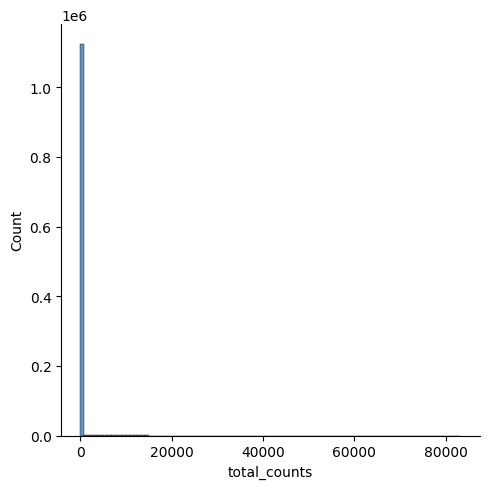

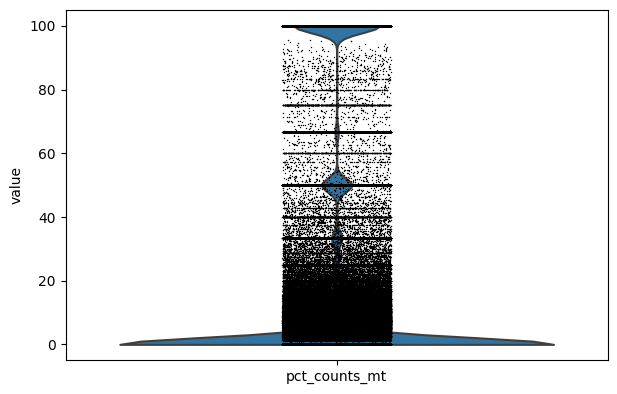

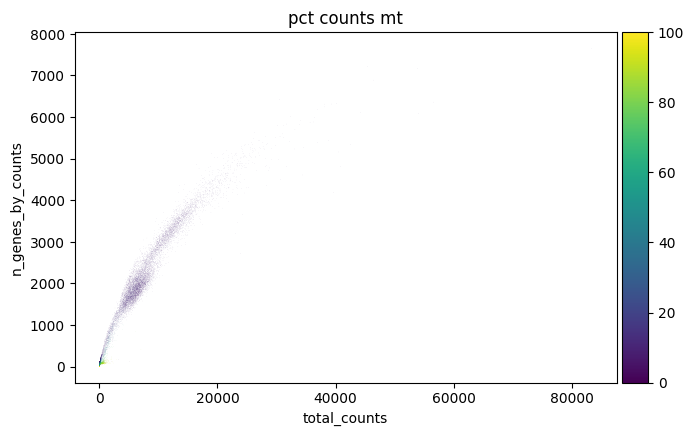

In [60]:
p1 = sns.displot(adata.obs["total_counts"], bins=100, kde=False)
# sc.pl.violin(adata, 'total_counts')
p2 = sc.pl.violin(adata, "pct_counts_mt")
p3 = sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_mt")

In [66]:
#TODO: check if we have the same results as in the results from pipeline
pct_mt_optimus = adata.obs["pct_mitochondrial_molecules"]
pct_mt_theis = adata.obs["pct_counts_mt"]

# Compare the two Series
if pct_mt_optimus.equals(pct_mt_theis):
    print("The two Series are the same.")
else:
    print("The two Series are different.")


The two Series are different.


In [68]:
pct_mt_optimus

AAACCCAAGAAACACT     0.000000
AAACCCAAGAAACCAT     0.000000
AAACCCAAGAAACTAC     0.000000
AAACCCAAGAAACTCA     6.250000
AAACCCAAGAAACTGT     0.000000
                      ...    
TTTGTTGTCTTGGTCC     0.000000
TTTGTTGTCTTGTACC     0.000000
TTTGTTGTCTTTACAC     0.000000
TTTGTTGTCTTTGCGC    15.000001
TTTGTTGTCTTTGCTA     0.000000
Name: pct_counts_mt, Length: 1136912, dtype: float32

In [69]:
pct_mt_theis

AAACCCAAGAAACACT    0.000000
AAACCCAAGAAACCAT    0.000000
AAACCCAAGAAACTAC    0.000000
AAACCCAAGAAACTCA    3.333333
AAACCCAAGAAACTGT    0.000000
                      ...   
TTTGTTGTCTTGGTCC    0.000000
TTTGTTGTCTTGTACC    0.000000
TTTGTTGTCTTTACAC    0.000000
TTTGTTGTCTTTGCGC    5.769231
TTTGTTGTCTTTGCTA    0.000000
Name: pct_mitochondrial_molecules, Length: 1136912, dtype: float64

In [82]:
for idx, (val1, val2) in enumerate(zip(pct_mt_optimus, pct_mt_theis)):
    if val1 != val2:
        print(f"Difference at index {idx}:")
        print(f"Difference at index {adata.obs['CellID'].iloc[idx]}:")
        
        print(f"pct_mt_optimus: {val1}")
        print(f"pct_mt_theis: {val2}")

Difference at index 3:
Difference at index AAACCCAAGAAACTCA:
pct_mt_optimus: 6.25
pct_mt_theis: 3.333333492
Difference at index 12:
Difference at index AAACCCAAGAAGTCTA:
pct_mt_optimus: 13.043478012084961
pct_mt_theis: 8.2191782
Difference at index 16:
Difference at index AAACCCAAGAATCTAG:
pct_mt_optimus: 33.333335876464844
pct_mt_theis: 23.52941132
Difference at index 17:
Difference at index AAACCCAAGACAACAT:
pct_mt_optimus: 5.15463924407959
pct_mt_theis: 2.962962866
Difference at index 18:
Difference at index AAACCCAAGACAACTA:
pct_mt_optimus: 50.0
pct_mt_theis: 15.78947258
Difference at index 22:
Difference at index AAACCCAAGACCACGA:
pct_mt_optimus: 5.617977619171143
pct_mt_theis: 2.272727251
Difference at index 25:
Difference at index AAACCCAAGACCTCCG:
pct_mt_optimus: 40.0
pct_mt_theis: 34.78260803
Difference at index 27:
Difference at index AAACCCAAGACCTTTG:
pct_mt_optimus: 50.0
pct_mt_theis: 75.0
Difference at index 28:
Difference at index AAACCCAAGACGAGCT:
pct_mt_optimus: 50.0
pc

filtering by library size

In [84]:
# have too much 0 for library size
barcodes_to_keep, _ = sc.pp.filter_cells(adata, min_counts=500, inplace = False)
# by default inplace = True, so adata is modified directly
adata = adata[barcodes_to_keep, :]
adata

View of AnnData object with n_obs × n_vars = 12283 × 58347
    obs: 'cell_names', 'CellID', 'emptydrops_Limited', 'emptydrops_IsCell', 'n_reads', 'noise_reads', 'perfect_molecule_barcodes', 'reads_mapped_exonic', 'reads_mapped_exonic_as', 'reads_mapped_intronic', 'reads_mapped_intronic_as', 'reads_mapped_uniquely', 'reads_mapped_multiple', 'duplicate_reads', 'spliced_reads', 'antisense_reads', 'n_molecules', 'n_fragments', 'fragments_with_single_read_evidence', 'molecules_with_single_read_evidence', 'perfect_cell_barcodes', 'reads_mapped_intergenic', 'reads_unmapped', 'reads_mapped_too_many_loci', 'n_genes', 'genes_detected_multiple_observations', 'emptydrops_Total', 'molecule_barcode_fraction_bases_above_30_mean', 'molecule_barcode_fraction_bases_above_30_variance', 'genomic_reads_fraction_bases_quality_above_30_mean', 'genomic_reads_fraction_bases_quality_above_30_variance', 'genomic_read_quality_mean', 'genomic_read_quality_variance', 'reads_per_molecule', 'reads_per_fragment', 'fra

In [87]:
### check if the genes without gene names are removed after filtering
# TODO:  add filtering for genes for the next step; see Alix nb
adata.var[adata.var['Gene'] == ""]

,gene_names,ensembl_ids,Gene,n_reads,noise_reads,perfect_molecule_barcodes,reads_mapped_exonic,reads_mapped_exonic_as,reads_mapped_intronic,reads_mapped_intronic_as,...,number_cells_expressing,mt,ribo,hb,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts
,,ENSG00000278704.1,,97.0,0.0,95.0,97.0,0.0,0.0,0.0,...,52.0,False,False,False,51,4.661750e-05,4.661642e-05,99.995514,53.0,3.988984
-1,,ENSG00000277400.1,,37.0,0.0,34.0,37.0,0.0,0.0,0.0,...,24.0,False,False,False,23,2.023024e-05,2.023003e-05,99.997977,23.0,3.178054
-2,,ENSG00000274847.1,,95.0,0.0,90.0,95.0,0.0,0.0,0.0,...,60.0,False,False,False,59,5.189496e-05,5.189361e-05,99.994811,59.0,4.094345
-3,,ENSG00000277428.1,,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,False,False,False,0,0.000000e+00,0.000000e+00,100.000000,0.0,0.000000
-4,,ENSG00000276256.1,,145.0,0.0,140.0,145.0,0.0,0.0,0.0,...,83.0,False,False,False,82,7.564350e-05,7.564064e-05,99.992787,86.0,4.465908
-5,,ENSG00000278198.1,,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,False,False,False,0,0.000000e+00,0.000000e+00,100.000000,0.0,0.000000
-6,,ENSG00000276932.1,,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,False,False,False,0,0.000000e+00,0.000000e+00,100.000000,0.0,0.000000
-7,,ENSG00000273496.1,,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,False,False,False,0,0.000000e+00,0.000000e+00,100.000000,0.0,0.000000
-8,,ENSG00000277630.4,,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,False,False,False,0,0.000000e+00,0.000000e+00,100.000000,0.0,0.000000
-9,,ENSG00000278793.1,,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,False,False,False,0,0.000000e+00,0.000000e+00,100.000000,0.0,0.000000


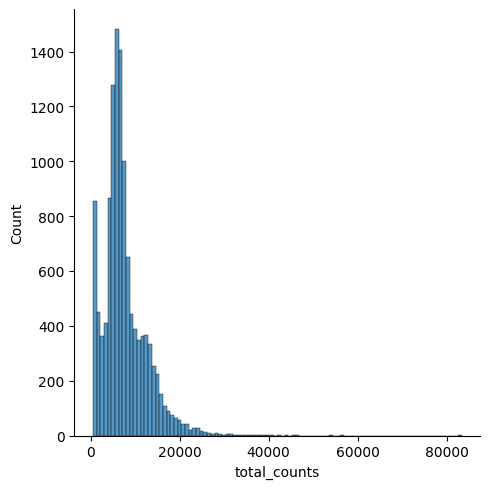

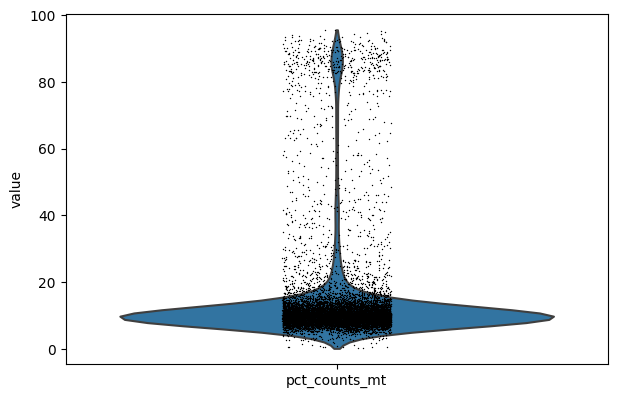

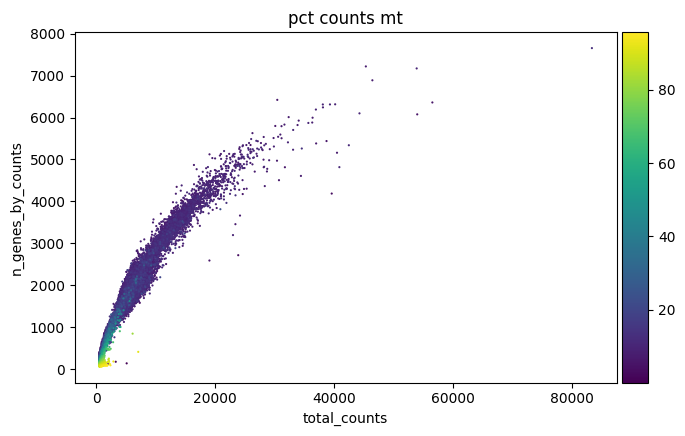

In [92]:
p1 = sns.displot(adata.obs["total_counts"], bins=100, kde=False)
# sc.pl.violin(adata, 'total_counts')
p2 = sc.pl.violin(adata, "pct_counts_mt")
p3 = sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_mt")

In [ ]:
# TODO: need to remove the %mt: see p2

In [93]:
def is_outlier(adata, metric: str, nmads: int):
    M = adata.obs[metric]
    outlier = (M < np.median(M) - nmads * median_abs_deviation(M)) | (
        np.median(M) + nmads * median_abs_deviation(M) < M
    )
    return outlier

In [94]:
# We now apply this function to the log1p_total_counts, log1p_n_genes_by_counts 
# and pct_counts_in_top_20_genes QC covariates each with a threshold of 5 MADs.
adata.obs["outlier"] = (
    is_outlier(adata, "log1p_total_counts", 5)
    | is_outlier(adata, "log1p_n_genes_by_counts", 5)
    | is_outlier(adata, "pct_counts_in_top_20_genes", 5)
)
adata.obs.outlier.value_counts()

/var/folders/1h/vw_l9z3s1f131f4qs27kksgw0000gp/T/ipykernel_76025/1036264593.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["outlier"] = (


False    11037
True      1246
Name: outlier, dtype: int64

In [95]:
#pct_counts_Mt is filtered with 3 MADs. Additionally, cells with 
#a percentage of mitochondrial counts exceeding 8 % are filtered out
adata.obs["mt_outlier"] = is_outlier(adata, "pct_counts_mt", 3) | (
    adata.obs["pct_counts_mt"] > 8
)
adata.obs.mt_outlier.value_counts()

True     9993
False    2290
Name: mt_outlier, dtype: int64

In [96]:
#We now filter our AnnData object based on these two additional columns.
print(f"Total number of cells: {adata.n_obs}")
adata = adata[(~adata.obs.outlier) & (~adata.obs.mt_outlier)].copy()

print(f"Number of cells after filtering of low quality cells: {adata.n_obs}")

Total number of cells: 12283
Number of cells after filtering of low quality cells: 2237


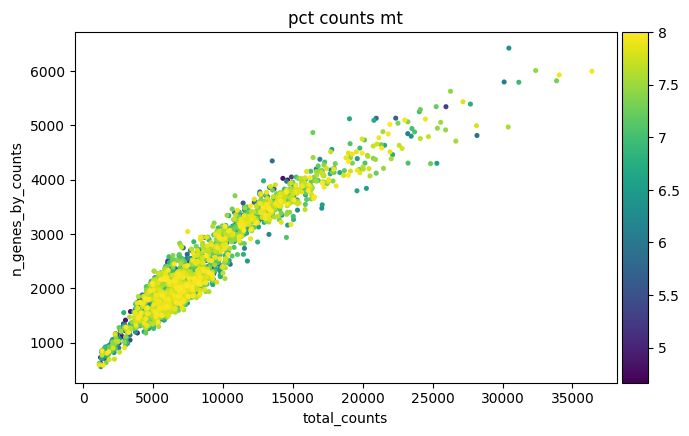

In [97]:
p1 = sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_mt")

#### 4. Correction of ambient RNA

In [ ]:
adata.layers["log_transformed"] = np.log1p(adata.X)
adata.to_df(layer="log_transformed")


In [ ]:
#faire QC, %mh,..., après umap
#cellbender prendre .h5 comme input
# read -> cell ranger -> raw count matrix + matrix retiré les barces peu reads/les empty droplet

#### Draft

In [ ]:
#import warnings
#warnings.filterwarnings("ignore")  # suppress warnings

raw data understanding

In [ ]:
### duplicate reads is always 0
display(adata.obs[adata.obs['duplicate_reads']== 0])
#display(adata.obs['duplicate_reads'].value_counts())

In [ ]:
### Fetch the data where the variable names are empty: they are probably absent in the reference annotation

# Access the 'var' attribute to work with variable information
var_df = adata.var
# Filter the data where the variable names are empty
empty_var_names = var_df[var_df.index == '']
#data_with_empty_var_names = adata[:, empty_var_names]
display(empty_var_names.head())

### check double variable names in the data with empty variable names
# Remove the variables with empty names from the 'adata' object
no_empty_varName_adata = adata[:, ~adata.var.index.isin(empty_var_names.index)]
no_empty_varName_adata

In [28]:
display(adata.uns)

OverloadedDict, wrapping:
	{'expression_data_type': 'exonic', 'input_id': '10k_pbmc_v3', 'optimus_output_schema_version': '1.0.1', 'pipeline_version': 'Optimus_v6.0.0'}
With overloaded keys:
	['neighbors'].

In [ ]:
import numpy as np

# sparse matrix is named 'sparse_matrix'
sparse_matrix = adata.X

# Convert the sparse matrix to a dense NumPy array
dense_matrix = sparse_matrix.toarray()

# use regular NumPy indexing to see the head
head = dense_matrix[:5, :]  # Assuming you want to see the first 5 rows
print(head)

In [ ]:
### n_reads is the same as perfect_molecule_barcodes
# Create a boolean mask to check if A and B are different
mask = adata.obs['n_reads'] != adata.obs['perfect_molecule_barcodes']

# Use the boolean mask to filter the rows where A and B are different
result = adata.obs[mask]

In [ ]:
result = adata.obs[["reads_mapped_exonic", "reads_mapped_intergenic"]].sum(axis=1)

In [ ]:
### find the calculation of pct_mitochondrial_molecules
#(adata.obs["n_mitochondrial_molecules"]*100)/adata.obs["pct_mitochondrial_molecules"]
pct_mt=adata.obs["n_mitochondrial_molecules"]/adata.obs["n_reads"]*100

# Compare the two Series
if pct_mt.equals(adata.obs["pct_mitochondrial_molecules"]):
    print("The two Series are the same.")
else:
    print("The two Series are different.")

# output the different between 2 Series
for idx, (val1, val2) in enumerate(zip(pct_mt, adata.obs["pct_mitochondrial_molecules"])):
    if val1 != val2:
        print(f"Difference at index {idx}:")
        print(f"Difference at index {adata.obs['CellID'].iloc[idx]}:")
        
        print(f"pct_mt: {val1}")
        print(f"pct_mt_in_h5ad: {val2}")
# the 2 resutls are almost the same